In [ ]:
Inserting the necessary libraries:

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
import os
import keras
from keras.layers import Dense,Conv2D,Dropout,BatchNormalization,Activation,Flatten,MaxPool2D,Input,LeakyReLU
from keras.models import Sequential
from keras.activations import relu
from keras.optimizers import Adam,RMSprop,SGD
from keras.preprocessing.image import ImageDataGenerator
from keras.utils import to_categorical
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from keras.applications.vgg16 import VGG16
from sklearn import svm
from keras.preprocessing import image
import xgboost
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
import os
import cv2
from sklearn.model_selection import train_test_split
import sklearn.preprocessing as sk
%matplotlib inline

In [1]:
import h5py
from keras.preprocessing.image import ImageDataGenerator

In [ ]:
Converting the given image dataset to an h5py file to make the processing easier:

In [ ]:
i) Creating the hdf5 file in write mode to write the contents from the image dataset to the file:

In [36]:
hdf5_path='plants.hdf5'

In [97]:
hdf5_path1='plants1.hdf5'

In [98]:
train_shape=(4767, 50, 50, 3)


In [99]:
f=h5py.File(hdf5_path1,mode='w')

In [ ]:
Appending the train image and labels to the x_train and y_train arrays:

In [18]:
x_train = []
y_train = []

In [5]:
for subfolder in os.listdir(train_path):
    for file in os.listdir(train_path+'/' +subfolder):
        path = train_path+'/' +subfolder+ "/" + file
        im = cv2.imread(path)
        ims = cv2.resize(im,(100,100))
        ims = ims/255
        x_train.append(ims)
        y_train.append(subfolder)

In [20]:
label_enc= sk.LabelEncoder()
y_train_enc = label_enc.fit_transform(y_train)

In [21]:
y_train1=to_categorical(y_train_enc)

In [ ]:
Defining the keys:
    The keys provided are train_image to store the image arrays and train_labels to store the corresponding labels.

In [100]:
f.create_dataset("train_image",train_shape,np.uint8)

<HDF5 dataset "train_image": shape (4767, 50, 50, 3), type "|u1">

In [48]:
f.keys()

<KeysViewHDF5 ['train_image', 'train_labels']>

In [ ]:
Storing the encoded train labels under the train_labels key of the hdf5 file:

In [101]:
f.create_dataset("train_labels", (4767,),np.uint8)
f["train_labels"][...] = y_train_enc

In [ ]:
Storing theimage arrays under the train_image keys of the hdf5 file:

In [102]:
i=0
for subfolder in os.listdir(train_path):
    for file in os.listdir(train_path+'/' +subfolder):
        print(i)
        path = train_path+'/' +subfolder+ "/" + file
        im = cv2.imread(path)
        ims = cv2.resize(im,(50,50))
        #ims = ims/255
        #x_train.append(ims)
        #y_train.append(subfolder)
        img = cv2.cvtColor(ims, cv2.COLOR_BGR2RGB)  # cv2 load images as BGR, convert it to RGB
        f["train_image"][i, ...] = img[None]
        i=i+1

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [ ]:
Closing the written file and reopening the file again in read mode:

In [103]:
f.close()

In [17]:
hf=h5py.File('plants1.hdf5', 'r') 

In [3]:
hf=h5py.File('plants.hdf5', 'r') 

In [4]:
hf.keys()

<KeysViewHDF5 ['train_image', 'train_labels']>

In [ ]:
Displaying a sample picture present in the file:

11


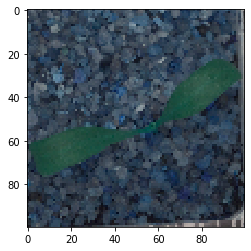

In [107]:
plt.imshow(x_train[4560])
print(y_train_enc[4560])

In [64]:
y_train_enc==1

array([False, False, False, ..., False, False, False])

11


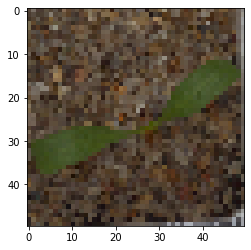

In [108]:
plt.imshow(hf['train_image'][4560])
print(hf["train_labels"][4560])

In [ ]:
Storing the train images and train labels from the file in separate variables:

In [18]:
x_train_hf=hf['train_image']
y_train_hf=hf['train_labels']

In [ ]:
Observing the shape of the input:

In [82]:
x_train_hf.shape

(4767, 50, 50, 3)

In [ ]:
Here the images have been resized to 50,50,3 in order to speed up training process:

In [ ]:
Finding the maximum and minimum values present in the input images:

In [ ]:
Since the values are in the range of 0-255 they need to be downscaled to the range of 0-1.

In [70]:
print(np.array(x_train_hf).max())
print(np.array(x_train_hf).min())

255
0


In [ ]:
Downscaling the images and carrying out one hot encoding the the output targets:

In [20]:
x_train_hf1=np.array(x_train_hf)/255

In [21]:
y_train_hf1=np.array(y_train_hf)

In [22]:
y_train_hf2=to_categorical(y_train_hf1)

In [ ]:
fig = plt.figure(figsize=(100,100))
j=1
for i in range(1, 101):
    ax = fig.add_subplot(10, 10, i)
    #ax.text(0.5, 0.5, str((2, 3, i)),
    #       fontsize=18, ha='center')
    ax.text(0.5, -1,(y_train_hf1[i-1]).astype(str),fontsize=50,ha='center')
    fig.subplots_adjust(hspace=0.2, wspace=0.4)
    plt.imshow(x_train_hf[i-1])
    j=j+50
    #print(np.argmax(Y1[i-1]))

C:\Program Files\Python37\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


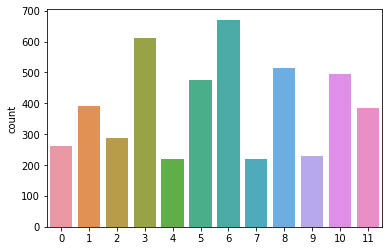

In [37]:
import seaborn as sns
sns.countplot(y_train_hf1)

In [52]:
x_train = []
y_train = []

In [51]:
train_path='train'
os.listdir(train_path)

['Black-grass',
 'Charlock',
 'Cleavers',
 'Common Chickweed',
 'Common wheat',
 'Fat Hen',
 'Loose Silky-bent',
 'Maize',
 'Scentless Mayweed',
 'Shepherds Purse',
 'Small-flowered Cranesbill',
 'Sugar beet']

In [5]:
for subfolder in os.listdir(train_path):
    for file in os.listdir(train_path+'/' +subfolder):
        path = train_path+'/' +subfolder+ "/" + file
        im = cv2.imread(path)
        ims = cv2.resize(im,(100,100))
        ims = ims/255
        x_train.append(ims)
        y_train.append(subfolder)

In [53]:
for subfolder in os.listdir(train_path):
    for file in os.listdir(train_path+'/' +subfolder):
        path = train_path+'/' +subfolder+ "/" + file
        #im = cv2.imread(path)
        #ims = cv2.resize(im,(100,100))
        #ims = ims/255
        #x_train.append(ims)
        y_train.append(subfolder)

In [54]:
label_enc= sk.LabelEncoder()
y_train_enc = label_enc.fit_transform(y_train)

In [21]:
y_train1=to_categorical(y_train_enc)

In [8]:
len(x_train)

4767

In [ ]:
Implementing supervised learning algorithms to train the model:

In [23]:
#x_train1 = [item.astype(int) for item in x_train]
X = np.array(x_train)

In [24]:
Y = np.array(y_train1)
Y1=np.array(y_train_enc)

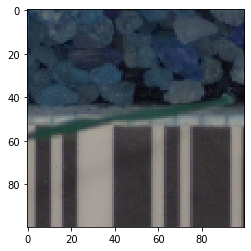

In [11]:
plt.imshow(X[0])

In [ ]:
i) Using Random Forest Classifier:

In [12]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
Flattening the input X image array:

In [13]:
X.shape

(4767, 100, 100, 3)

In [25]:
reshaped_x = X.reshape(X.shape[0], -1)

In [15]:
reshaped_x.shape

(4767, 30000)

In [16]:
y_train_enc

array([ 0,  0,  0, ..., 11, 11, 11], dtype=int64)

In [ ]:
Splitting the data into train and test data respectively:

In [ ]:
x_tr,x_test,y_tr,y_test=train_test_split(reshaped_x,Y1,test_size=0.2,random_state=42)

In [ ]:
Defining the random forest classifier using 300 estimators:

In [25]:
rf_model = RandomForestClassifier(n_estimators=300)
rf_model.fit(x_tr, y_tr)

RandomForestClassifier(n_estimators=300)

In [26]:
y_pred=rf_model.predict(x_test)

In [ ]:
Obtaining the accuracy score:

In [27]:
accuracy_score(y_pred,y_test)

0.5545073375262054

In [ ]:
The accuracy is 55% which is pretty bad.

In [ ]:
ii) Using SVM Model to train the data:

In [ ]:
Defining the model:

In [21]:
svm_model = svm.SVC()

In [ ]:
Fitting the model using train data:

In [22]:
svm_model.fit(x_tr, y_tr)

SVC()

In [ ]:
Obtaining the accuracy of test data predictions:

In [23]:
y_pred=svm_model.predict(x_test)

In [24]:
accuracy_score(y_pred,y_test)

0.5020964360587002

In [ ]:
The accuracy is 50% which is even worse.

In [ ]:
ii) Using simple fully connected neural networks to train the given data:

In [9]:
from tensorflow.keras.layers import Reshape
from tensorflow.keras import regularizers

In [ ]:
i) Using 5 hidden layers,each containing 1024,512,256,256 and 256 neurons respectively.
ii) Adding dropout of 0.3 and 0.2 to first and 3rd layers.

In [13]:
model2 = Sequential()
model2.add(Reshape((100*100*3,), input_shape=(100,100,3), name='Input_layer'))
#model2.add(BatchNormalization()) 
model2.add(Dense(1024, kernel_initializer='he_normal'))
model2.add(Activation('relu'))  
model2.add(Dropout(0.3))
#model2.add(BatchNormalization())
model2.add(Dense(512,kernel_initializer='he_normal'))
model2.add(Activation('relu'))  
#model2.add(Dropout(0.2))
#model2.add(BatchNormalization())
model2.add(Dense(256,kernel_initializer='he_normal'))
#model2.add(BatchNormalization())  
model2.add(Activation('relu'))
model2.add(Dropout(0.2))
#model2.add(BatchNormalization())
model2.add(Dense(256,kernel_initializer='he_normal'))
#model2.add(BatchNormalization())  
model2.add(Activation('relu'))
#model2.add(Dropout(0.2))
#model2.add(BatchNormalization())
model2.add(Dense(256,kernel_initializer='he_normal'))
#model2.add(BatchNormalization())  
model2.add(Activation('relu'))
#model2.add(Dropout(0.2))
model2.add(Dense(12, activation='softmax'))
model2.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Input_layer (Reshape)        (None, 30000)             0         
_________________________________________________________________
dense_6 (Dense)              (None, 1024)              30721024  
_________________________________________________________________
activation_5 (Activation)    (None, 1024)              0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_7 (Dense)              (None, 512)               524800    
_________________________________________________________________
activation_6 (Activation)    (None, 512)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 256)              

In [ ]:
Defining the image data generator to augment the images and train on more images as a result:

In [14]:
gen = ImageDataGenerator(
            
            horizontal_flip=True,
            vertical_flip=True
    )
initial_learning_rate = 0.001 #initial rate
# Rate decay with exponential decay
# new rate = initial_learning_rate * decay_rate ^ (step / decay_steps)

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=800,
    decay_rate=0.5,
    staircase=True)
mypotim = SGD(lr=1 * 1e-1, momentum=0.9, nesterov=True)
#model1.compile(loss='categorical_crossentropy',
                   #optimizer=mypotim,
                   #metrics=['accuracy'])
model2.compile(optimizer=tf.keras.optimizers.Adam(lr_schedule),loss=tf.keras.losses.CategoricalCrossentropy(),
              metrics=['accuracy'])
model2.fit_generator(gen.flow(x_tr, y_tr,batch_size=50),
               
               epochs=50,
               verbose=1,
               shuffle=True
               )


Epoch 1/50
77/77 [==============================] - 68s 432ms/step - loss: 5.8741 - accuracy: 0.1027
Epoch 2/50
77/77 [==============================] - 32s 408ms/step - loss: 2.4835 - accuracy: 0.1305
Epoch 3/50
77/77 [==============================] - 31s 408ms/step - loss: 2.4635 - accuracy: 0.1252
Epoch 4/50
77/77 [==============================] - 32s 412ms/step - loss: 2.4432 - accuracy: 0.1308
Epoch 5/50
77/77 [==============================] - 32s 413ms/step - loss: 2.4406 - accuracy: 0.1281
Epoch 6/50
77/77 [==============================] - 32s 409ms/step - loss: 2.4357 - accuracy: 0.1289
Epoch 7/50
77/77 [==============================] - 32s 410ms/step - loss: 2.4290 - accuracy: 0.1334
Epoch 8/50
77/77 [==============================] - 32s 410ms/step - loss: 2.4259 - accuracy: 0.1432
Epoch 9/50
77/77 [==============================] - 32s 409ms/step - loss: 2.4219 - accuracy: 0.1251
Epoch 10/50
77/77 [==============================] - 32s 412ms/step - loss: 2.4082 - accura

In [ ]:
An accuracy of 25% is obtained which is even lower than that of supervised algorithms.

In [ ]:
Modifying the above neural network with the reduction of the number of neurons to observe change in performance:

In [15]:
model2 = Sequential()
model2.add(Reshape((100*100*3,), input_shape=(100,100,3), name='Input_layer'))
#model2.add(BatchNormalization()) 
model2.add(Dense(256, kernel_initializer='he_normal'))
model2.add(Activation('relu'))  
model2.add(Dropout(0.3))
#model2.add(BatchNormalization())
model2.add(Dense(256,kernel_initializer='he_normal'))
model2.add(Activation('relu'))  
#model2.add(Dropout(0.2))
#model2.add(BatchNormalization())
model2.add(Dense(256,kernel_initializer='he_normal'))
#model2.add(BatchNormalization())  
model2.add(Activation('relu'))
model2.add(Dropout(0.2))
#model2.add(BatchNormalization())
model2.add(Dense(256,kernel_initializer='he_normal'))
#model2.add(BatchNormalization())  
model2.add(Activation('relu'))
#model2.add(Dropout(0.2))
#model2.add(BatchNormalization())
model2.add(Dense(256,kernel_initializer='he_normal'))
#model2.add(BatchNormalization())  
model2.add(Activation('relu'))
#model2.add(Dropout(0.2))
model2.add(Dense(12, activation='softmax'))
model2.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Input_layer (Reshape)        (None, 30000)             0         
_________________________________________________________________
dense_12 (Dense)             (None, 256)               7680256   
_________________________________________________________________
activation_10 (Activation)   (None, 256)               0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_13 (Dense)             (None, 256)               65792     
_________________________________________________________________
activation_11 (Activation)   (None, 256)               0         
_________________________________________________________________
dense_14 (Dense)             (None, 256)              

In [16]:
gen = ImageDataGenerator(
            
            horizontal_flip=True,
            vertical_flip=True
    )
initial_learning_rate = 0.0001 #initial rate
# Rate decay with exponential decay
# new rate = initial_learning_rate * decay_rate ^ (step / decay_steps)

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=800,
    decay_rate=0.5,
    staircase=True)
mypotim = SGD(lr=1 * 1e-1, momentum=0.9, nesterov=True)
#model1.compile(loss='categorical_crossentropy',
                   #optimizer=mypotim,
                   #metrics=['accuracy'])
model2.compile(optimizer=tf.keras.optimizers.Adam(lr_schedule),loss=tf.keras.losses.CategoricalCrossentropy(),
              metrics=['accuracy'])
model2.fit_generator(gen.flow(x_tr, y_tr,batch_size=50),
               
               epochs=50,
               verbose=1,
               shuffle=True
               )

Epoch 1/50
77/77 [==============================] - 12s 114ms/step - loss: 2.5757 - accuracy: 0.1099
Epoch 2/50
77/77 [==============================] - 9s 114ms/step - loss: 2.4278 - accuracy: 0.1259
Epoch 3/50
77/77 [==============================] - 9s 114ms/step - loss: 2.4216 - accuracy: 0.1365
Epoch 4/50
77/77 [==============================] - 9s 115ms/step - loss: 2.4040 - accuracy: 0.1534
Epoch 5/50
77/77 [==============================] - 9s 115ms/step - loss: 2.3852 - accuracy: 0.1809
Epoch 6/50
77/77 [==============================] - 9s 114ms/step - loss: 2.3277 - accuracy: 0.1888
Epoch 7/50
77/77 [==============================] - 9s 114ms/step - loss: 2.2971 - accuracy: 0.1922
Epoch 8/50
77/77 [==============================] - 9s 114ms/step - loss: 2.2518 - accuracy: 0.2067
Epoch 9/50
77/77 [==============================] - 9s 114ms/step - loss: 2.2331 - accuracy: 0.1967
Epoch 10/50
77/77 [==============================] - 9s 115ms/step - loss: 2.1936 - accuracy: 0.206

In [ ]:
There has been no improvement.

In [16]:
x_tr.shape

(3813, 50, 50, 3)

In [ ]:
Using CNN to train the given data:
    i) The first CNN block has 64 filters of stride 1 with an l2 regularization of 0.1,Batch Normalization Layer,LeakyRelu activation and maxpooling layer.
    ii) The 2nd CNN block has 128 filters of stride 3 with an l2 regularization parameter of 0.01 followed by the same layers as that of the 1st block.
    iii) A dropout of 0.4 has been added
    iv)The 3rd CNN block consists of 256 filters of stride 5 followed by the same layers as that of the previous blocks.
    v)The 4th CNN block consists of 64 filters of stride 5 followed by the same layers as that of the previous blocks and a dropout of 0.4.
    vi) A fully connected dense neural network is added with 2 hidden layers to train on the essential features obtained from the convolution blocks.

In [125]:
model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(64, 1, activation=None,kernel_regularizer=tf.keras.regularizers.l2(0.1), input_shape=(50,50,3)),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Conv2D(128, 3, activation=None,padding="same",kernel_regularizer=tf.keras.regularizers.l2(0.01)),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Dropout(0.4),
    
    tf.keras.layers.Conv2D(256, 5, activation=None,kernel_regularizer=tf.keras.regularizers.l2(0.01)),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Conv2D(64, 5, activation=None,padding="same",kernel_regularizer=tf.keras.regularizers.l2(0.01)),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Dropout(0.4),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(100,kernel_regularizer=tf.keras.regularizers.l2(0.01), activation=None),
    tf.keras.layers.BatchNormalization(axis=1),
    tf.keras.layers.ReLU(),
    
    tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Dense(50,kernel_regularizer=tf.keras.regularizers.l2(0.01), activation=None),
    tf.keras.layers.BatchNormalization(axis=1),
    tf.keras.layers.ReLU(),
    
    tf.keras.layers.Dense(12, kernel_regularizer=tf.keras.regularizers.l2(0.01) ,activation='softmax')
])


In [ ]:
Defining the initial learning followed by a scheduler in order to carry out exponential decay of learning rate for optimal convergence:

In [126]:
initial_learning_rate = 0.001 #initial rate
# Rate decay with exponential decay
# new rate = initial_learning_rate * decay_rate ^ (step / decay_steps)

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=800,
    decay_rate=0.5,
    staircase=True)

In [ ]:
Using Adam optimizer and categorical crossentropy loss to train the model:

In [127]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),loss=tf.keras.losses.CategoricalCrossentropy(),
              metrics=['accuracy'])

In [ ]:
Splitting the input data to train and test data respectively:

In [11]:
x_tr,x_test,y_tr,y_test=train_test_split(x_train_hf1,y_train_hf2,test_size=0.2,random_state=42)

In [129]:
result = model.fit(x=x_tr,y=y_tr,batch_size=10,epochs=50,verbose=1,shuffle=True,initial_epoch=0,
                   validation_split=0.2)

Epoch 1/50
305/305 [==============================] - 175s 530ms/step - loss: 7.7574 - accuracy: 0.2082 - val_loss: 4.9955 - val_accuracy: 0.1494
Epoch 2/50
305/305 [==============================] - 150s 493ms/step - loss: 3.6187 - accuracy: 0.4154 - val_loss: 4.1722 - val_accuracy: 0.0773
Epoch 3/50
305/305 [==============================] - 158s 518ms/step - loss: 2.7708 - accuracy: 0.4576 - val_loss: 3.7163 - val_accuracy: 0.1507
Epoch 4/50
305/305 [==============================] - 148s 487ms/step - loss: 2.2959 - accuracy: 0.5207 - val_loss: 3.6099 - val_accuracy: 0.1494
Epoch 5/50
305/305 [==============================] - 149s 489ms/step - loss: 2.1588 - accuracy: 0.5291 - val_loss: 2.9868 - val_accuracy: 0.2228
Epoch 6/50
305/305 [==============================] - 148s 487ms/step - loss: 2.0587 - accuracy: 0.5601 - val_loss: 2.2447 - val_accuracy: 0.3827
Epoch 7/50
305/305 [==============================] - 150s 492ms/step - loss: 1.7960 - accuracy: 0.6399 - val_loss: 2.1503 -

In [ ]:
From the above results, it can be seen that a training accuracy of 84% followed by a validation accuracy of 87% has been obtained which is a big jump as compared to the previously trained models using supervised learning and neural networks.

In [130]:
model.evaluate(x_test,y_test)

30/30 [==============================] - 10s 313ms/step - loss: 0.8455 - accuracy: 0.8637


[0.8454973101615906, 0.8637316823005676]

In [90]:
x_tr.shape

(3813, 100, 100, 3)

In [91]:
Y.shape

(4767, 12)

In [92]:
y_train_hf2.shape

(4767, 12)

In [93]:
X.shape

(4767, 100, 100, 3)

In [ ]:
Modifying the above CNN:
    i)The CNN is trained without the l2 regularization parameter which had been added to each CNN block previously.
    ii) The images are augmented to generate more training examples as compared to those trained in the previous network.    

In [24]:
model1 = tf.keras.Sequential([
    tf.keras.layers.Conv2D(64, 1, activation=None,#kernel_regularizer=tf.keras.regularizers.l2(0.1),
                           input_shape=(50,50,3)),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Conv2D(128, 3, activation=None,padding="same",#kernel_regularizer=tf.keras.regularizers.l2(0.01)
                          ),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Dropout(0.4),
    
    tf.keras.layers.Conv2D(256, 5, activation=None,#kernel_regularizer=tf.keras.regularizers.l2(0.01)
                          ),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Conv2D(64, 5, activation=None,padding="same",#kernel_regularizer=tf.keras.regularizers.l2(0.01)
                          ),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Dropout(0.4),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(100,kernel_regularizer=tf.keras.regularizers.l2(0.01), activation=None),
    tf.keras.layers.BatchNormalization(axis=1),
    tf.keras.layers.ReLU(),
    
    tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Dense(50,kernel_regularizer=tf.keras.regularizers.l2(0.01), activation=None),
    tf.keras.layers.BatchNormalization(axis=1),
    tf.keras.layers.ReLU(),
    
    tf.keras.layers.Dense(12, kernel_regularizer=tf.keras.regularizers.l2(0.01) ,activation='softmax')
])


In [ ]:
rotation_range=360.,
            width_shift_range=0.3,
            height_shift_range=0.3,
            zoom_range=0.3,

In [23]:
x_tr,x_test,y_tr,y_test=train_test_split(x_train_hf1,y_train_hf2,test_size=0.2,random_state=42)

In [ ]:
Defining the learning rate and compiling and fitting the model using Adam Optimizer and Categorical Crossentropy.

In [25]:
gen = ImageDataGenerator(
            
            horizontal_flip=True,
            vertical_flip=True
    )
initial_learning_rate = 0.001 #initial rate
# Rate decay with exponential decay
# new rate = initial_learning_rate * decay_rate ^ (step / decay_steps)

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=800,
    decay_rate=0.5,
    staircase=True)
#mypotim = SGD(lr=1 * 1e-1, momentum=0.9, nesterov=True)
#model1.compile(loss='categorical_crossentropy',
                   #optimizer=mypotim,
                   #metrics=['accuracy'])
model1.compile(optimizer=tf.keras.optimizers.Adam(lr_schedule),loss=tf.keras.losses.CategoricalCrossentropy(),
              metrics=['accuracy'])
model1.fit_generator(gen.flow(x_tr, y_tr,batch_size=50),
               
               epochs=50,
               verbose=1,
               shuffle=True
               )

Epoch 1/50
77/77 [==============================] - 188s 2s/step - loss: 4.5878 - accuracy: 0.1956
Epoch 2/50
77/77 [==============================] - 174s 2s/step - loss: 3.3772 - accuracy: 0.3852
Epoch 3/50
77/77 [==============================] - 177s 2s/step - loss: 2.5903 - accuracy: 0.5402
Epoch 4/50
77/77 [==============================] - 184s 2s/step - loss: 2.0501 - accuracy: 0.6349
Epoch 5/50
77/77 [==============================] - 177s 2s/step - loss: 1.6954 - accuracy: 0.6836
Epoch 6/50
77/77 [==============================] - 174s 2s/step - loss: 1.4312 - accuracy: 0.7248
Epoch 7/50
77/77 [==============================] - 184s 2s/step - loss: 1.2508 - accuracy: 0.7515
Epoch 8/50
77/77 [==============================] - 190s 2s/step - loss: 1.0919 - accuracy: 0.7761
Epoch 9/50
77/77 [==============================] - 181s 2s/step - loss: 1.0133 - accuracy: 0.7825
Epoch 10/50
77/77 [==============================] - 178s 2s/step - loss: 0.8960 - accuracy: 0.8086
Epoch 11/

In [26]:
model1.evaluate(x_test,y_test)

30/30 [==============================] - 40s 293ms/step - loss: 0.3327 - accuracy: 0.9350


[0.3326890766620636, 0.9350104928016663]

In [ ]:
It can be seen that the accuracy is 94% with a test accuracy of 93% which is good. This will be taken as the best model.

In [ ]:
Using the model to predict the given image:

In [ ]:
i) Importing the image to be predicted.

In [28]:
img=cv2.imread('predict.png')

In [ ]:
Resizing and downscaling the image as required for prediction by the model:

In [29]:
img1=cv2.resize(img,(50,50))
x_pred=np.array(img1)/255

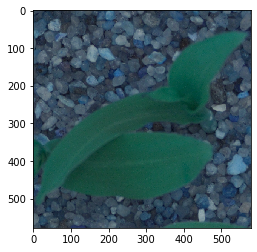

In [49]:
plt.imshow(img)

In [ ]:
Reshaping the input image array and predicting the same:

In [30]:
x_pred=x_pred.reshape(1,50,50,3)

In [32]:
y_pred=model1.predict(x_pred)

In [56]:
np.argmax(y_pred)

4

In [60]:
label_enc.inverse_transform([4])

array(['Common wheat'], dtype='<U25')

In [ ]:
Saving the model for future use:

In [34]:
model1.save('plant_seedling_model.hdf5')

In [ ]:
Generating the confusion matrix:

In [75]:
from sklearn.metrics import confusion_matrix

In [65]:
model1=load_model('plant_seedling_model.hdf5')

In [66]:
y_pred1=model1.predict(x_test)

C:\Users\DELL\AppData\Roaming\Python\Python37\site-packages\tensorflow\python\keras\engine\training.py:2291: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  warnings.warn('`Model.state_updates` will be removed in a future version. '


In [76]:
confusion_matrix(np.argmax(y_pred1,axis=1),np.argmax(y_test,axis=1))

array([[ 31,   0,   0,   0,   1,   0,   2,   0,   0,   0,   0,   0],
       [  0,  77,   0,   0,   0,   1,   0,   0,   0,   0,   0,   0],
       [  0,   2,  58,   0,   0,   1,   0,   0,   0,   0,   0,   0],
       [  0,   0,   0, 122,   0,   0,   0,   0,   0,   1,   0,   0],
       [  0,   0,   0,   0,  37,   0,   0,   0,   0,   0,   0,   0],
       [  2,   1,   0,   0,   0,  79,   0,   0,   0,   0,   0,   0],
       [ 34,   0,   0,   0,   0,   0, 129,   0,   0,   0,   1,   0],
       [  0,   0,   0,   0,   0,   0,   0,  44,   0,   0,   0,   0],
       [  1,   0,   1,   0,   0,   0,   0,   0,  94,   4,   0,   0],
       [  0,   1,   0,   2,   0,   0,   1,   0,   0,  34,   1,   0],
       [  0,   0,   0,   1,   0,   2,   0,   0,   0,   0, 103,   0],
       [  0,   0,   0,   0,   0,   0,   0,   2,   0,   0,   0,  84]],
      dtype=int64)

In [ ]:
The class 0 images have been misclassified the most while other classes have not been misclassified much.

In [ ]:
Comparison of all the algorithms and models trained above:
    i) The CNN trained model provides the best results among all the models trained above. The addition of image data generator,the regularization parameters in certain areas and learning rate scheduler seem to provide an improvement in the performance. 
    ii)The random forest and svm classifiers used prove to be slightly better than that of neural networks.
    iii) Class 0 is misclassified the most among all the classes.
    iv) The image data generator needs to be carefully constructed since the model is trained better when many attributes are remove from the image data generator such as the rotation range,zoom factor,shift, etc.
    v) The speed of training speeds up when the size of the images are reduced to 50,50,3.

Part 2:
i)CNNs help capturing the essential information,i.e the spatial information in the image using convolution filters and also help reduce the number of parameters by capturing only the important information and can help prevent overfitting and reduce the complexity of the model as well. Due to translational invariance, the position of the essential patterns to be captured does not matter. The connections are reduced as well since only local neurons are connected with each other and share weights. This is not present in the normal artificial neural networks. In the case of images of very large size such as 224,224,3 as seen above, the number of parameters after flattening the images increases drastically which makes it very difficult to train the model and capture the spatial information as well. Fully connected neural networks do not possess translation invariance and thus their performance gets affected with change in positions as a result of which the necessary information cannot be captured. 
ii) The neural networks need not always outperform the machine learning algorithms as seen above where the Random Forest Classifier and SVC classifier seemed to provide better results with the same input that was provided to the neural networks. Thus neural networks may perform better if designed carefully and providing input such that all the patterns in the images are always present at the same points without any shifting or variations in their positions. They can also perform better when the data provided is large enough with lesser number of parameters to be trained, thereby reducing the complexity and preventing overfitting. The neural networks can also be exposed to vanishing gradients or exploding gradients when large number of parameters are provided and can get stuck in local minima without moving forward.
iii)In the case above, although neural networks generally prevent overfitting more than that of supervised learning and are better in non linearity classifications, the use of large number of parameters with very less data has made it difficult for neural networks to generalize the input and train on the input.

In [ ]:
Part 4:
    i) Importing the dataset:

In [10]:
import tflearn.datasets.oxflower17 as oxflower17 

Instructions for updating:
non-resource variables are not supported in the long term
curses is not supported on this machine (please install/reinstall curses for an optimal experience)


In [45]:
oxflower17

<module 'tflearn.datasets.oxflower17' from 'C:\\Program Files\\Python37\\lib\\site-packages\\tflearn\\datasets\\oxflower17.py'>

In [46]:
X, Y = oxflower17.load_data(one_hot=True)

100.0% 60276736 / 60270631


Succesfully downloaded 17flowers.tgz 60270631 bytes.
File Extracted
Starting to parse images...
Parsing Done!


In [11]:
X1, Y1 = oxflower17.load_data(dirname='17flowers1')

In [77]:
Y1[7]

2

In [ ]:
Displaying the 1st 10 input images:

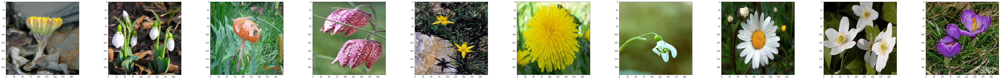

In [12]:
fig = plt.figure(figsize=(100,100))

for i in range(1, 11):
    ax = fig.add_subplot(10, 10, i)
    #ax.text(0.5, 0.5, str((2, 3, i)),
    #       fontsize=18, ha='center')
    #ax.text(0.5, -1,(Y1[i-1]).astype(str),fontsize=50,ha='center')
    fig.subplots_adjust(hspace=0.2, wspace=0.4)
    plt.imshow(X1[i-1])
    #print(np.argmax(Y1[i-1]))

In [ ]:
Displaying the labels of the 1st 10 input images:

In [13]:
for i in range(1, 11):
    print(Y1[i-1])
    #ax = fig.add_subplot(10, 10, i)
    #ax.text(0.5, 0.5, str((2, 3, i)),
    #       fontsize=18, ha='center')
    #ax.text(0.5, -1,(Y1[i-1]).astype(str),fontsize=50,ha='center')
    #fig.subplots_adjust(hspace=0.2, wspace=0.4)
    #plt.imshow(X1[i-1])

3
1
13
15
14
4
1
2
7
11


In [ ]:
Displaying the 1st 100 images with their labels:

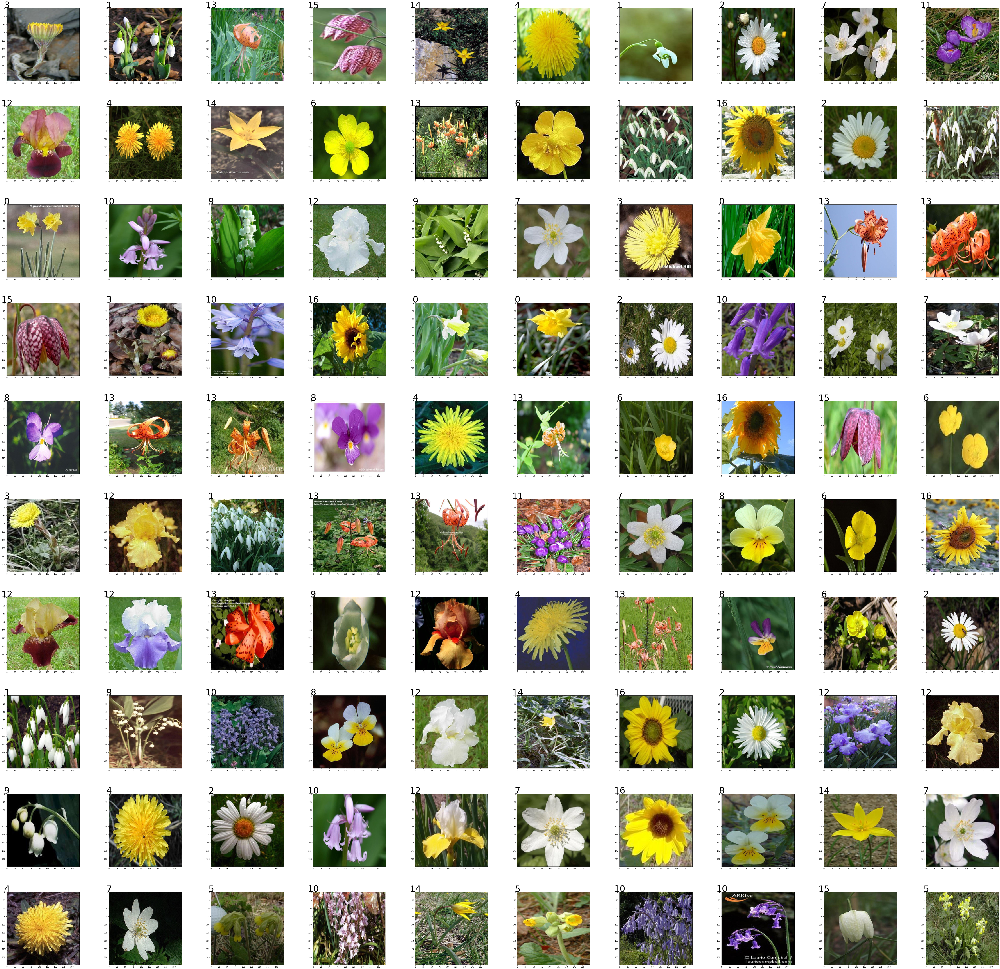

In [80]:
fig = plt.figure(figsize=(100,100))

for i in range(1, 101):
    ax = fig.add_subplot(10, 10, i)
    #ax.text(0.5, 0.5, str((2, 3, i)),
    #       fontsize=18, ha='center')
    ax.text(0.5, -1,(Y1[i-1]).astype(str),fontsize=50,ha='center')
    fig.subplots_adjust(hspace=0.2, wspace=0.4)
    plt.imshow(X1[i-1])
    #print(np.argmax(Y1[i-1]))

In [68]:
Y1[0]

array([0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [67]:
np.argmax(Y1[0])

4

In [48]:
type(X)

numpy.ndarray

In [49]:
import tensorflow as tf

In [ ]:
Obtaining the shape of the input data:
    It can be seen that the shape of the image is 224,224,3

In [50]:
X.shape

(1360, 224, 224, 3)

In [51]:
Y.shape

(1360, 17)

In [ ]:
Using different filters on the images and displaying them:
    The filters used are blur,sobel,laplacian and sharpening filters.

In [93]:
# construct average blurring kernels used to smooth an image
smallBlur = np.ones((7, 7), dtype="float") * (1.0 / (7 * 7))
largeBlur = np.ones((21, 21), dtype="float") * (1.0 / (21 * 21))
# construct a sharpening filter
sharpen = np.array((
[0, -1, 0],
[-1, 5, -1],
[0, -1, 0]), dtype="int")

In [94]:
laplacian = np.array((
[0, 1, 0],
[1, -4, 1],
[0, 1, 0]), dtype="int")
# construct the Sobel x-axis kernel
sobelX = np.array((
[-1, 0, 1],
[-2, 0, 2],
[-1, 0, 1]), dtype="int")
# construct the Sobel y-axis kernel
sobelY = np.array((
[-1, -2, -1],
[0, 0, 0],
[1, 2, 1]), dtype="int")

In [95]:
kernelBank = (
("small_blur", smallBlur),
("large_blur", largeBlur),
("sharpen", sharpen),
("laplacian", laplacian),
("sobel_x", sobelX),
("sobel_y", sobelY)
)

In [16]:
class_imgs=os.listdir('17flowers1/jpg')

In [17]:
class_imgs[0:-2]

['0',
 '1',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9']

In [100]:
os.listdir('17flowers/jpg/'+'0')[0]

'image_0001.jpg'

In [ ]:
Displaying the first image of each label with the applied filters:

[INFO] applying small_blur kernel


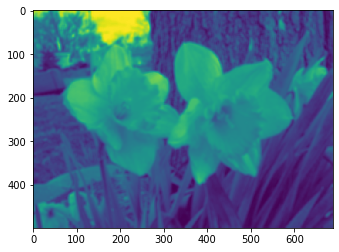

[INFO] applying large_blur kernel


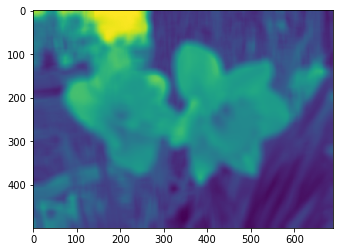

[INFO] applying sharpen kernel


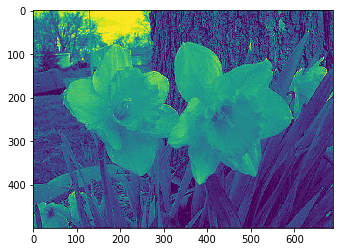

[INFO] applying laplacian kernel


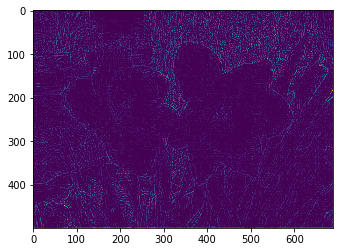

[INFO] applying sobel_x kernel


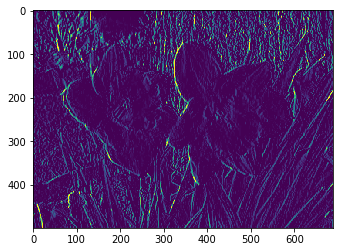

[INFO] applying sobel_y kernel


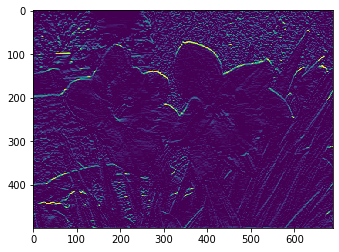

[INFO] applying small_blur kernel


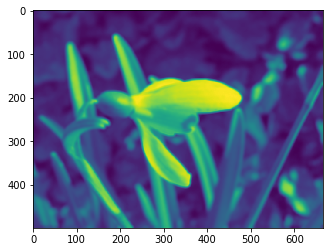

[INFO] applying large_blur kernel


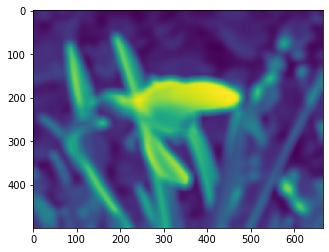

[INFO] applying sharpen kernel


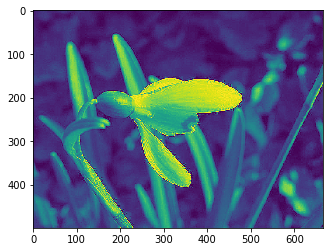

[INFO] applying laplacian kernel


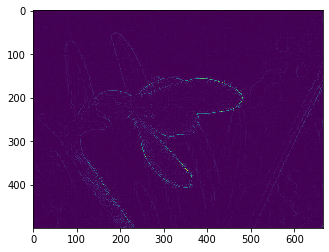

[INFO] applying sobel_x kernel


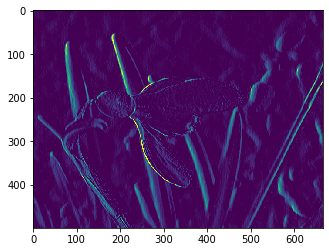

[INFO] applying sobel_y kernel


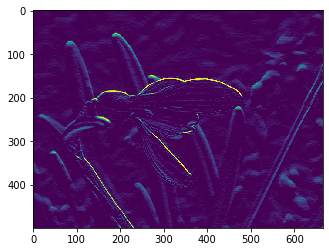

[INFO] applying small_blur kernel


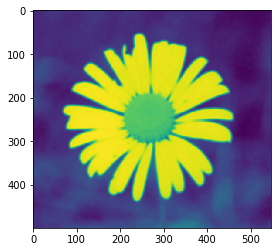

[INFO] applying large_blur kernel


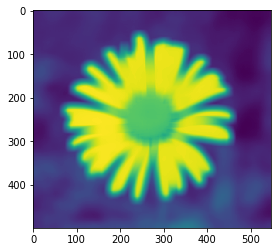

[INFO] applying sharpen kernel


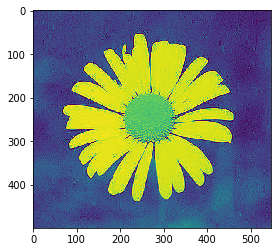

[INFO] applying laplacian kernel


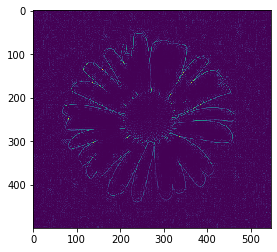

[INFO] applying sobel_x kernel


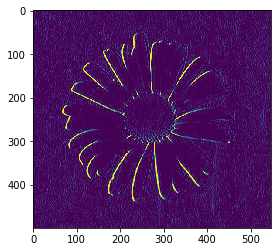

[INFO] applying sobel_y kernel


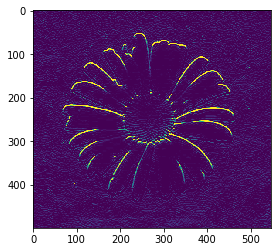

[INFO] applying small_blur kernel


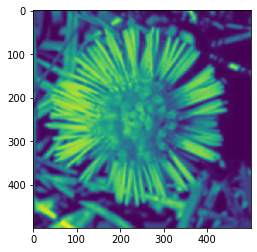

[INFO] applying large_blur kernel


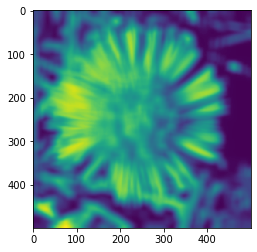

[INFO] applying sharpen kernel


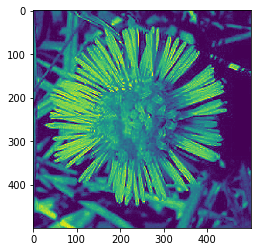

[INFO] applying laplacian kernel


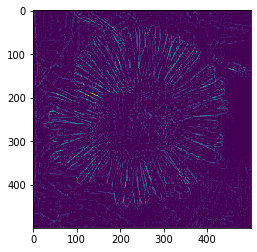

[INFO] applying sobel_x kernel


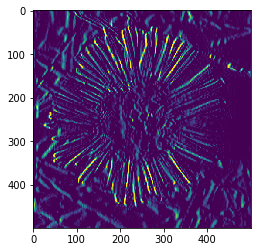

[INFO] applying sobel_y kernel


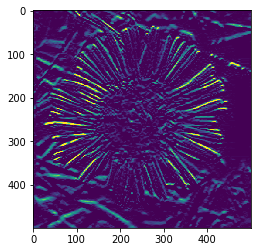

[INFO] applying small_blur kernel


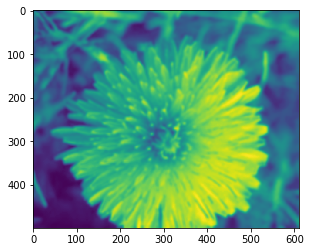

[INFO] applying large_blur kernel


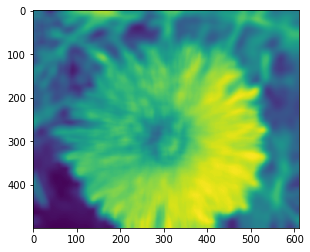

[INFO] applying sharpen kernel


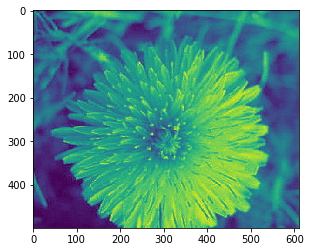

[INFO] applying laplacian kernel


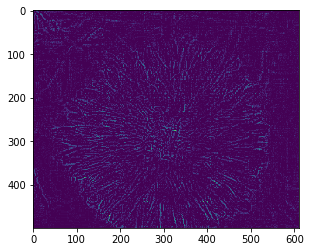

[INFO] applying sobel_x kernel


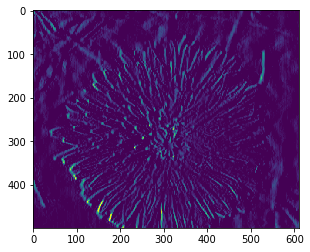

[INFO] applying sobel_y kernel


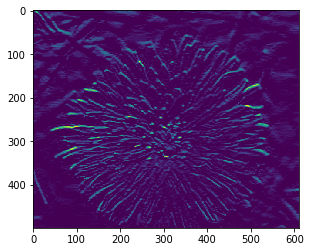

[INFO] applying small_blur kernel


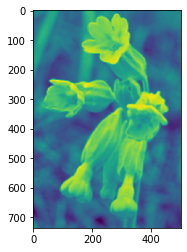

[INFO] applying large_blur kernel


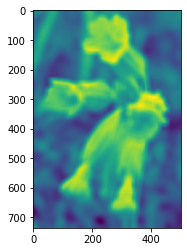

[INFO] applying sharpen kernel


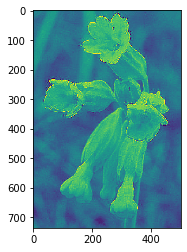

[INFO] applying laplacian kernel


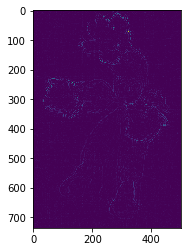

[INFO] applying sobel_x kernel


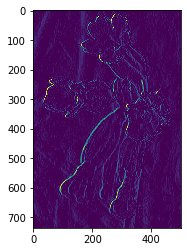

[INFO] applying sobel_y kernel


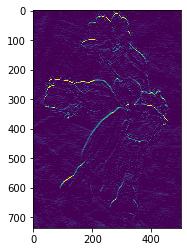

[INFO] applying small_blur kernel


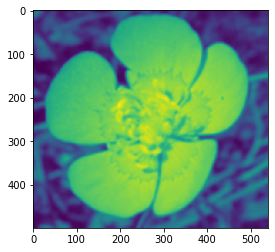

[INFO] applying large_blur kernel


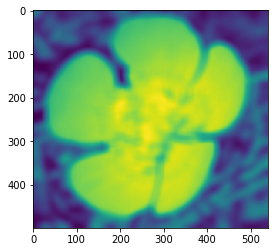

[INFO] applying sharpen kernel


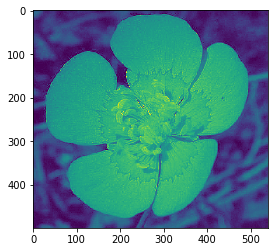

[INFO] applying laplacian kernel


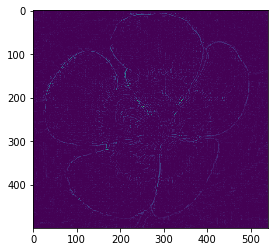

[INFO] applying sobel_x kernel


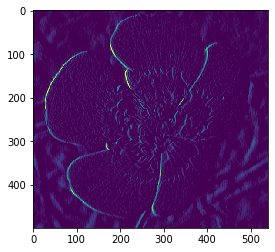

[INFO] applying sobel_y kernel


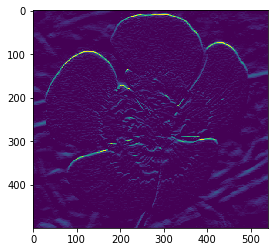

[INFO] applying small_blur kernel


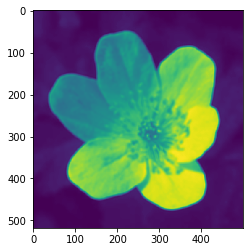

[INFO] applying large_blur kernel


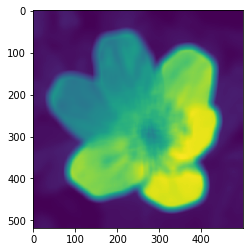

[INFO] applying sharpen kernel


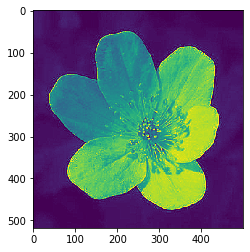

[INFO] applying laplacian kernel


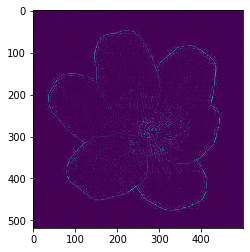

[INFO] applying sobel_x kernel


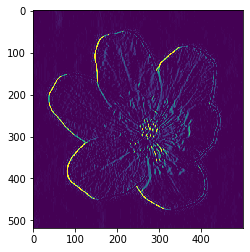

[INFO] applying sobel_y kernel


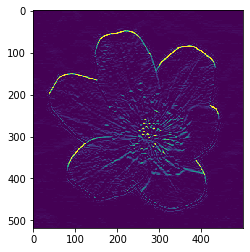

[INFO] applying small_blur kernel


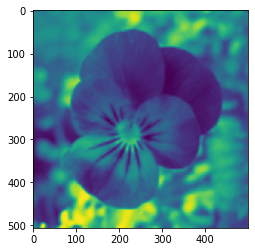

[INFO] applying large_blur kernel


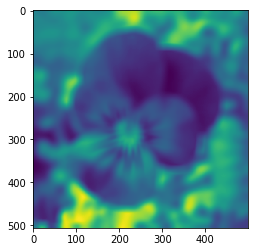

[INFO] applying sharpen kernel


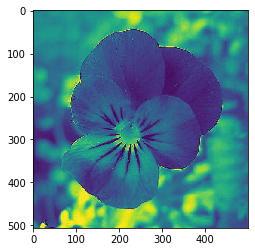

[INFO] applying laplacian kernel


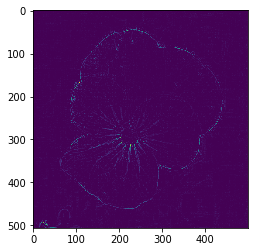

[INFO] applying sobel_x kernel


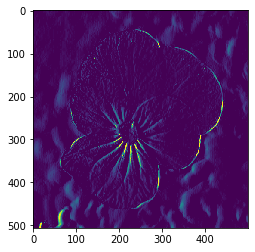

[INFO] applying sobel_y kernel


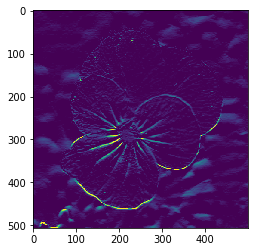

[INFO] applying small_blur kernel


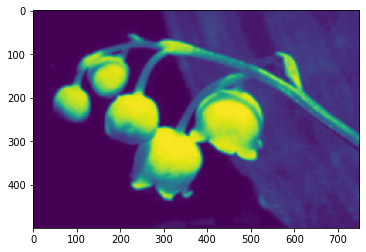

[INFO] applying large_blur kernel


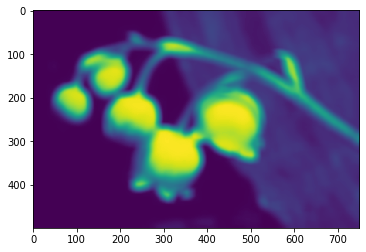

[INFO] applying sharpen kernel


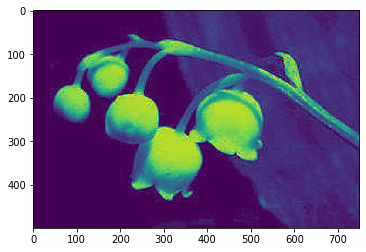

[INFO] applying laplacian kernel


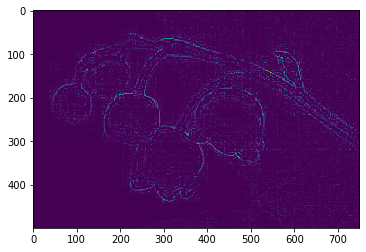

[INFO] applying sobel_x kernel


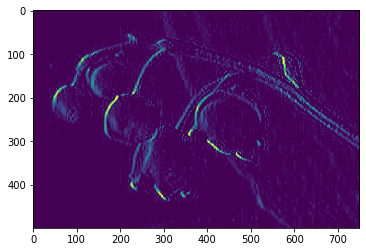

[INFO] applying sobel_y kernel


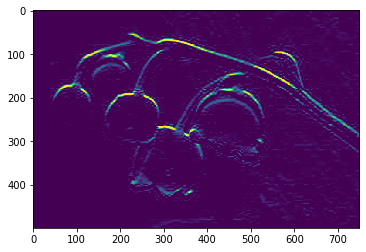

[INFO] applying small_blur kernel


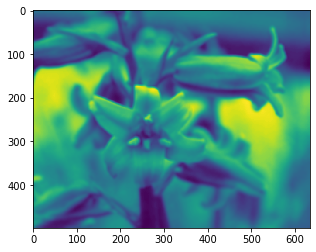

[INFO] applying large_blur kernel


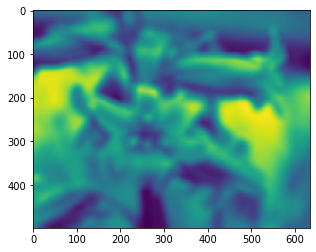

[INFO] applying sharpen kernel


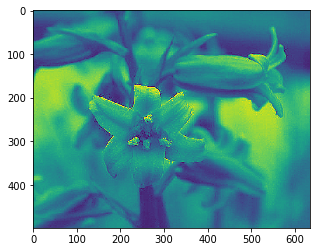

[INFO] applying laplacian kernel


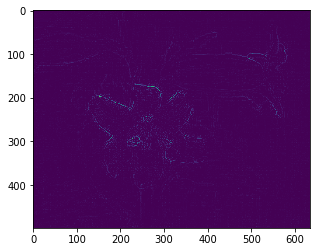

[INFO] applying sobel_x kernel


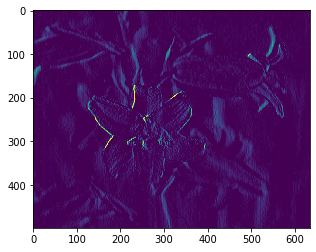

[INFO] applying sobel_y kernel


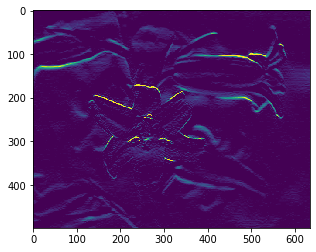

[INFO] applying small_blur kernel


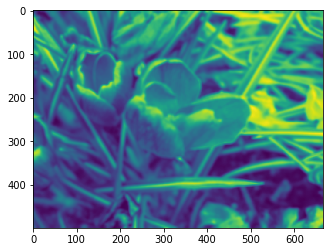

[INFO] applying large_blur kernel


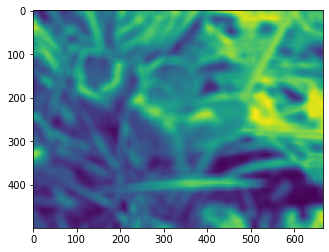

[INFO] applying sharpen kernel


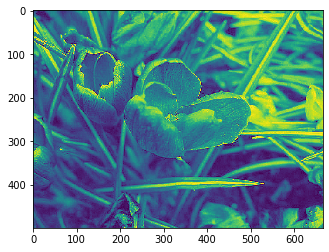

[INFO] applying laplacian kernel


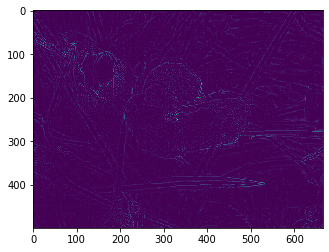

[INFO] applying sobel_x kernel


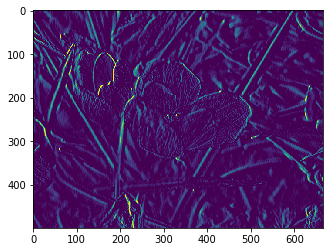

[INFO] applying sobel_y kernel


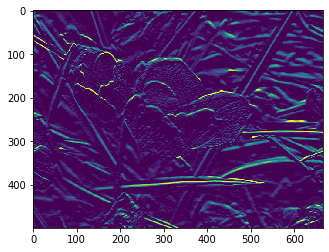

[INFO] applying small_blur kernel


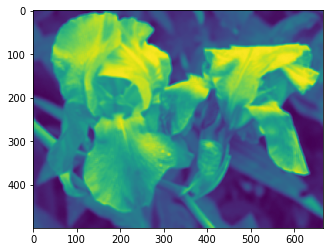

[INFO] applying large_blur kernel


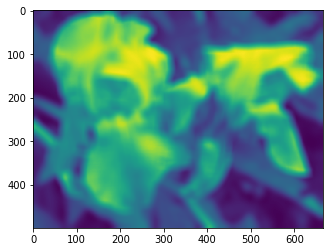

[INFO] applying sharpen kernel


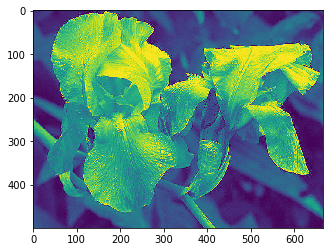

[INFO] applying laplacian kernel


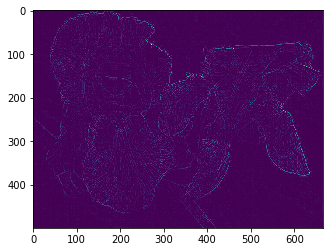

[INFO] applying sobel_x kernel


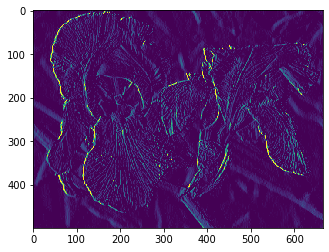

[INFO] applying sobel_y kernel


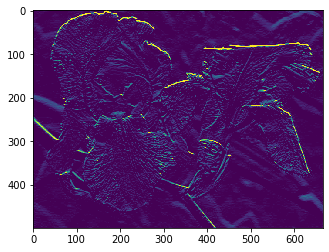

[INFO] applying small_blur kernel


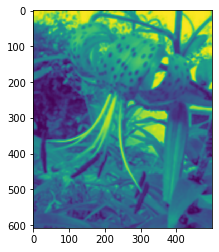

[INFO] applying large_blur kernel


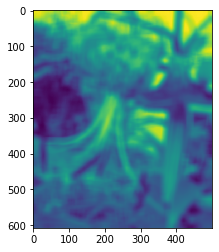

[INFO] applying sharpen kernel


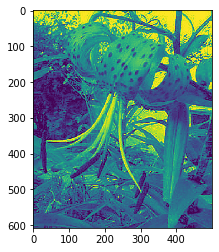

[INFO] applying laplacian kernel


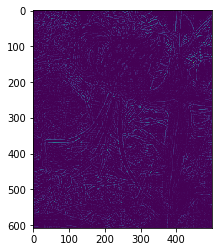

[INFO] applying sobel_x kernel


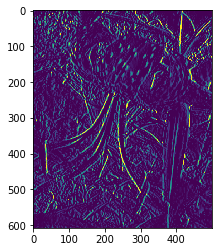

[INFO] applying sobel_y kernel


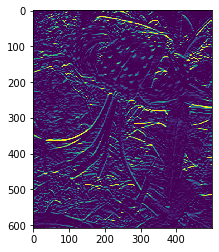

[INFO] applying small_blur kernel


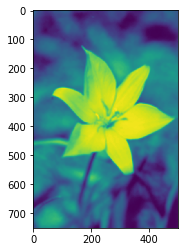

[INFO] applying large_blur kernel


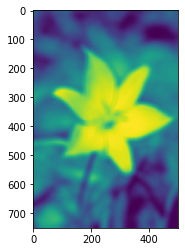

[INFO] applying sharpen kernel


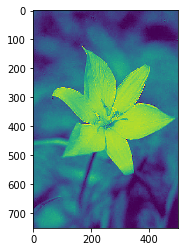

[INFO] applying laplacian kernel


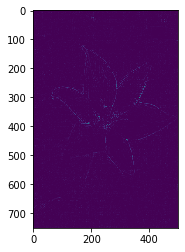

[INFO] applying sobel_x kernel


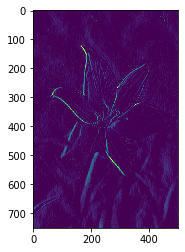

[INFO] applying sobel_y kernel


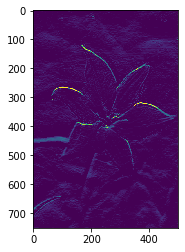

[INFO] applying small_blur kernel


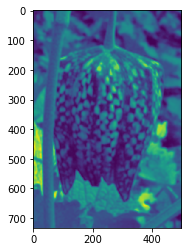

[INFO] applying large_blur kernel


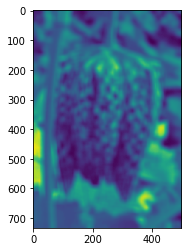

[INFO] applying sharpen kernel


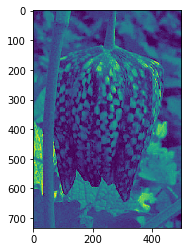

[INFO] applying laplacian kernel


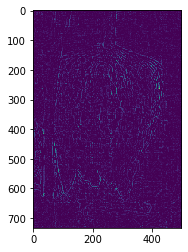

[INFO] applying sobel_x kernel


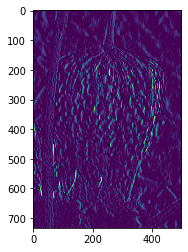

[INFO] applying sobel_y kernel


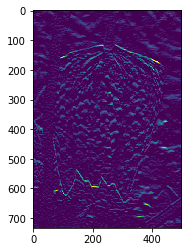

[INFO] applying small_blur kernel


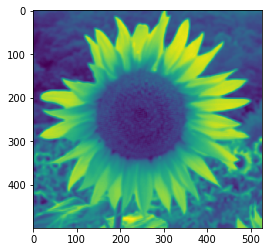

[INFO] applying large_blur kernel


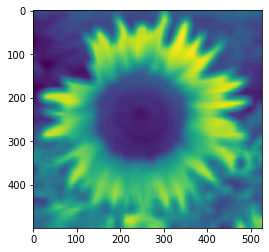

[INFO] applying sharpen kernel


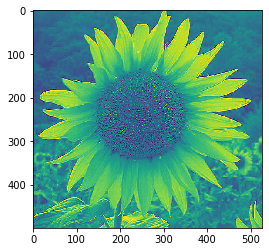

[INFO] applying laplacian kernel


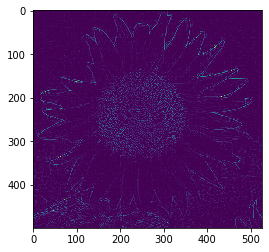

[INFO] applying sobel_x kernel


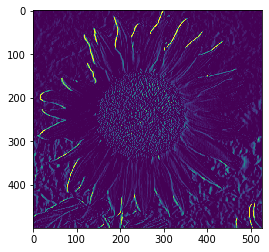

[INFO] applying sobel_y kernel


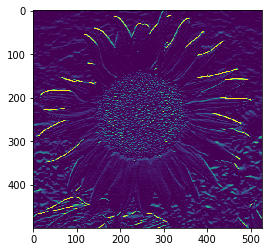

In [106]:
for i in class_imgs[0:-2]:
    img_path=os.listdir('17flowers/jpg/'+i)[0]
    image = cv2.imread('17flowers/jpg/'+i+'/'+img_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
# loop over the kernels
    for (kernelName, kernel) in kernelBank:
        
# apply the kernel to the grayscale image using both
# our custom `convole` function and OpenCV's `filter2D`
# function
        print("[INFO] applying {} kernel".format(kernelName))
    
        opencvOutput = cv2.filter2D(gray, -1, kernel)
# show the output images
        plt.imshow(gray)

        plt.imshow(opencvOutput)
        plt.show()
    

In [ ]:
Applying emboss filter:

In [14]:
kernel = np.array([[-2, -1, 0],
                    [-1, 1, 1],
                    [-1, 1, 2]])

offset = 128

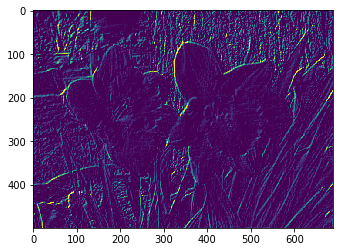

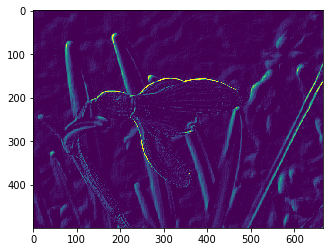

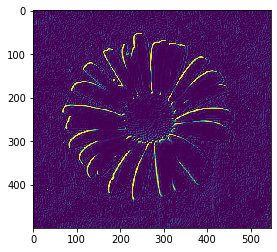

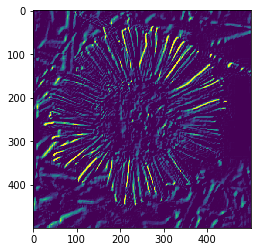

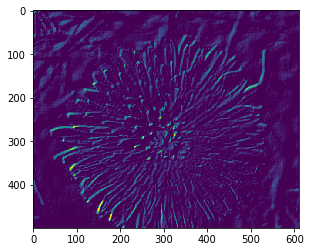

...

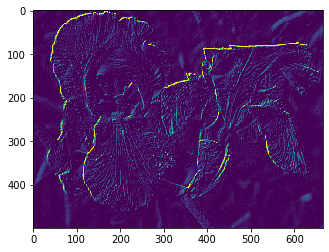

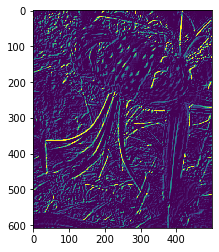

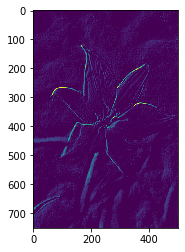

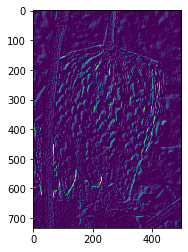

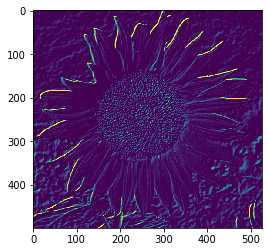

In [18]:
for i in class_imgs[0:-2]:
    img_path=os.listdir('17flowers/jpg/'+i)[0]
    image = cv2.imread('17flowers/jpg/'+i+'/'+img_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
# loop over the kernels
    
        
# apply the kernel to the grayscale image using both
# our custom `convole` function and OpenCV's `filter2D`
# function
    #print("[INFO] applying {} kernel".format(kernelName))

    opencvOutput = cv2.filter2D(gray, -1, kernel)
# show the output images
    plt.imshow(gray)

    plt.imshow(opencvOutput)
    plt.show()

In [ ]:
As seen above different filters have been applied and can help highlight the edges and sharpen important features in the image. Blurring can help provide an overall generalized pattern of the image by removing the noise. The sobel and laplacian filters can help detect edges

In [81]:
X1.shape

(1360, 224, 224, 3)

In [8]:
X1.max()

1.0

In [8]:
X1.min()

0.0

In [6]:
im = cv2.imread('17flowers/jpg/0'+'/'+os.listdir('17flowers/jpg/0')[0])

In [7]:
im.shape

(500, 689, 3)

In [9]:
x_train=[]
y_train=[]

In [10]:
train_path='17flowers/jpg'
for subfolder in os.listdir(train_path)[0:-2]:
    for file in os.listdir(train_path+'/' +subfolder):
        path = train_path+'/' +subfolder+ "/" + file
        im = cv2.imread(path)
        ims = cv2.resize(im,(100,100))
        ims = ims/255
        x_train.append(ims)
        y_train.append(subfolder)

In [11]:
x_train1=np.array(x_train)
y_train1=np.array(y_train)

In [12]:
y_train2=to_categorical(y_train1)

In [9]:
from keras.layers.core import Dropout
from keras.layers.core import Flatten
from keras.layers.core import Dense
from keras.applications import VGG16
from keras.optimizers import RMSprop
from keras.optimizers import SGD
from keras.layers import Input
from keras.models import Model

In [ ]:
Defining the generator for the CNN in order generate augmented images for better results:

In [27]:
aug = ImageDataGenerator(#rotation_range=10,zoom_range=0.1, shear_range=0.1, 
    width_shift_range=0.1,height_shift_range=0.1,vertical_flip=True,
horizontal_flip=True, fill_mode="nearest")

In [11]:
Y2=to_categorical(Y1)

In [13]:
(trainX, testX, trainY, testY) = train_test_split(x_train1, y_train2,
test_size=0.2, random_state=42)

In [14]:
(valX, testX1, valY, testY1) = train_test_split(testX, testY,
test_size=0.5, random_state=42)

In [14]:
baseModel = VGG16(weights="imagenet", include_top=False, input_tensor=Input(shape=(224, 224, 3)))

In [12]:
headModel = baseModel.output
headModel = Flatten(name="flatten")(headModel)
headModel = Dense(256, activation="relu")(headModel)
headModel = Dropout(0.5)(headModel)
headModel = Dense(17, activation="softmax")(headModel)

In [13]:
model = Model(inputs=baseModel.input, outputs=headModel)
# loop over all layers in the base model and freeze them so they
# will *not* be updated during the training process
for layer in baseModel.layers:
    layer.trainable = False


In [ ]:
opt = RMSprop(lr=0.001)
model.compile(loss="categorical_crossentropy", optimizer=opt,
metrics=["accuracy"])

# train the head of the network for a few epochs (all other
# layers are frozen) -- this will allow the new FC layers to
# start to become initialized with actual "learned" values
# versus pure random
print("[INFO] training head...")
model.fit_generator(aug.flow(trainX, trainY, batch_size=32),
validation_data=(valX, valY), epochs=25,
steps_per_epoch=len(trainX) // 32, verbose=1)

[INFO] training head...


C:\Users\DELL\AppData\Roaming\Python\Python37\site-packages\tensorflow\python\keras\engine\training_v1.py:1236: UserWarning: `model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`model.fit_generator` is deprecated and '


Epoch 1/25


In [25]:
model_cnn = tf.keras.Sequential([
    tf.keras.layers.Conv2D(64, 1, activation=None,#kernel_regularizer=tf.keras.regularizers.l2(0.1),
                           input_shape=(100,100,3)),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Conv2D(128, 3, activation=None,padding="same",#kernel_regularizer=tf.keras.regularizers.l2(0.01)
                          ),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Dropout(0.4),
    
    tf.keras.layers.Conv2D(256, 5, activation=None,#kernel_regularizer=tf.keras.regularizers.l2(0.01)
                          ),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Conv2D(64, 5, activation=None,padding="same",#kernel_regularizer=tf.keras.regularizers.l2(0.01)
                          ),
    tf.keras.layers.BatchNormalization(axis=3),
    tf.keras.layers.LeakyReLU(0.1),
    tf.keras.layers.MaxPool2D(strides=2),
    
    tf.keras.layers.Dropout(0.4),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(100,kernel_regularizer=tf.keras.regularizers.l2(0.01), activation=None),
    tf.keras.layers.BatchNormalization(axis=1),
    tf.keras.layers.ReLU(),
    
    tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Dense(50,kernel_regularizer=tf.keras.regularizers.l2(0.01), activation=None),
    tf.keras.layers.BatchNormalization(axis=1),
    tf.keras.layers.ReLU(),
    
    tf.keras.layers.Dense(17, kernel_regularizer=tf.keras.regularizers.l2(0.01) ,activation='softmax')
])


In [ ]:
Defining the CNN below:

In [30]:
from keras.layers import Convolution2D
from keras.layers import MaxPooling2D

In [ ]:
i) 3 Convolution blocks of 32 filters and 64 filtes of size 3,3 are added along with maxpooling and dropouts of 0.25 and 0.5.
   A dense fully connected layer is added to train on the essential features captured.


In [31]:
model = Sequential() #Initlialising the neural network
input_shape = (100,100,3) #Channels RGB
#First convolution and pooling
model.add(Convolution2D(32,(3,3),input_shape=input_shape,padding='same',activation = 'relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.25))
#Second convolution and pooling
model.add(Convolution2D(64,(3,3),padding='same',activation='relu')) #Changing the filter from 34 to 64 as we go deeper into the network
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.25))

#Third layer of convoluting and pooling
model.add(Convolution2D(64,(3,3),padding='same',activation='relu')) #Increasing the filters
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.50)) #More details are learned so therefore dropout function is increased to avoid overfitting

#Flattening
model.add(Flatten())
#Connecting the layers
model.add(Dense(1000)) #Connecting each layers with 1000 neurons

#Classifier
model.add(Dense(17)) #Depending on the classes there will be certain number of nodes 
model.add(Activation("softmax")) #More than 2 category of outpu

In [ ]:
Using RMSprop optimizer with a learning rate of 0.001 and categorical crossentropy loss to train the CNN:

In [32]:
opt = RMSprop(lr=0.001)
model.compile(loss="categorical_crossentropy", optimizer=opt,
metrics=["accuracy"])

# train the head of the network for a few epochs (all other
# layers are frozen) -- this will allow the new FC layers to
# start to become initialized with actual "learned" values
# versus pure random
#print("[INFO] training head...")
model.fit_generator(aug.flow(trainX, trainY, batch_size=32),
validation_data=(valX, valY), epochs=50,
 verbose=1)

Epoch 1/50
34/34 [==============================] - 67s 1s/step - loss: 5.8309 - accuracy: 0.0586 - val_loss: 2.6140 - val_accuracy: 0.1397
Epoch 2/50
34/34 [==============================] - 41s 1s/step - loss: 2.6661 - accuracy: 0.1608 - val_loss: 2.2877 - val_accuracy: 0.1985
Epoch 3/50
34/34 [==============================] - 42s 1s/step - loss: 2.2349 - accuracy: 0.2429 - val_loss: 2.1896 - val_accuracy: 0.2353
Epoch 4/50
34/34 [==============================] - 43s 1s/step - loss: 2.0397 - accuracy: 0.3168 - val_loss: 1.8040 - val_accuracy: 0.4706
Epoch 5/50
34/34 [==============================] - 41s 1s/step - loss: 1.7847 - accuracy: 0.3845 - val_loss: 1.7585 - val_accuracy: 0.3750
Epoch 6/50
34/34 [==============================] - 42s 1s/step - loss: 1.6223 - accuracy: 0.4252 - val_loss: 1.4361 - val_accuracy: 0.5368
Epoch 7/50
34/34 [==============================] - 42s 1s/step - loss: 1.5600 - accuracy: 0.4933 - val_loss: 1.5009 - val_accuracy: 0.4926
Epoch 8/50
34/34 [==

In [ ]:
From the above results it can be seen that the validation accuracy is around 71% while the train accuracy is nearly 80%

In [ ]:
Modifying the above CNN by adding another hidden layer to the fully connected neural network in order to observe change in performance:

In [37]:
model = Sequential() #Initlialising the neural network
input_shape = (100,100,3) #Channels RGB
#First convolution and pooling
model.add(Convolution2D(32,(3,3),input_shape=input_shape,padding='same',activation = 'relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.25))
#Second convolution and pooling
model.add(Convolution2D(64,(3,3),padding='same',activation='relu')) #Changing the filter from 34 to 64 as we go deeper into the network
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.25))

#Third layer of convoluting and pooling
model.add(Convolution2D(64,(3,3),padding='same',activation='relu')) #Increasing the filters
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.4)) #More details are learned so therefore dropout function is increased to avoid overfitting

#Flattening
model.add(Flatten())
#Connecting the layers
model.add(Dense(1000)) #Connecting each layers with 1000 neurons
model.add(Activation("relu"))
model.add(Dropout(0.3))
model.add(Dense(500))
model.add(Activation("relu"))

#Classifier
model.add(Dense(17)) #Depending on the classes there will be certain number of nodes 
model.add(Activation("softmax")) #More than 2 category of outpu

In [38]:
aug = ImageDataGenerator(#rotation_range=10,zoom_range=0.1, shear_range=0.1,, height_shift_range=0.1
    width_shift_range=0.1,vertical_flip=True,
horizontal_flip=True, fill_mode="nearest")

In [ ]:
The Adam optimizer with a learning rate of 0.001 is used along with categorical crossentropy loss in order to compile and train the CNN:

In [39]:
initial_learning_rate = 0.001 #initial rate
# Rate decay with exponential decay
# new rate = initial_learning_rate * decay_rate ^ (step / decay_steps)

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate,
    decay_steps=800,
    decay_rate=0.5,
    staircase=True)
#mypotim = SGD(lr=1 * 1e-1, momentum=0.9, nesterov=True)
#model1.compile(loss='categorical_crossentropy',
                   #optimizer=mypotim,
                   #metrics=['accuracy'])
model.compile(optimizer=tf.keras.optimizers.Adam(lr_schedule),loss=tf.keras.losses.CategoricalCrossentropy(),
              metrics=['accuracy'])
model.fit_generator(aug.flow(trainX, trainY, batch_size=32),
validation_data=(valX, valY), epochs=100,
 verbose=1,shuffle=True)

Epoch 1/100
34/34 [==============================] - 45s 1s/step - loss: 2.7143 - accuracy: 0.1182 - val_loss: 2.2685 - val_accuracy: 0.1838
Epoch 2/100
34/34 [==============================] - 41s 1s/step - loss: 2.2333 - accuracy: 0.2238 - val_loss: 2.0650 - val_accuracy: 0.2868
Epoch 3/100
34/34 [==============================] - 41s 1s/step - loss: 1.9115 - accuracy: 0.3568 - val_loss: 1.8079 - val_accuracy: 0.3897
Epoch 4/100
34/34 [==============================] - 41s 1s/step - loss: 1.6363 - accuracy: 0.4375 - val_loss: 1.5312 - val_accuracy: 0.5515
Epoch 5/100
34/34 [==============================] - 41s 1s/step - loss: 1.5355 - accuracy: 0.4622 - val_loss: 1.5787 - val_accuracy: 0.4412
Epoch 6/100
34/34 [==============================] - 39s 1s/step - loss: 1.3786 - accuracy: 0.5099 - val_loss: 1.4683 - val_accuracy: 0.5074
Epoch 7/100
34/34 [==============================] - 40s 1s/step - loss: 1.2715 - accuracy: 0.5648 - val_loss: 1.6042 - val_accuracy: 0.4338
Epoch 8/100
3

In [40]:
model.evaluate(testX1,testY1)

5/5 [==============================] - 1s 241ms/step - loss: 1.5705 - accuracy: 0.7132


[1.5704602003097534, 0.7132353186607361]

In [ ]:
Although the train accuracy has increased to 99%,the validation accuracy and test accuracy remain in the same range of 70=80% thereby indication overfitting of the model.

In [54]:
X1, Y1 = oxflower17.load_data(dirname='17flowers2',resize_pics=(100,100))

100.0% 60276736 / 60270631


Succesfully downloaded 17flowers.tgz 60270631 bytes.
File Extracted
Starting to parse images...
Parsing Done!


In [60]:
Y2=to_categorical(Y1)

In [50]:
from tensorflow.keras.applications import resnet50

In [51]:
basemodel = resnet50.ResNet50(include_top=False, weights='imagenet', input_shape=(100, 100, 3))

94773248/94765736 [==============================] - 18s 0us/step


In [59]:
X1.shape

(1360, 100, 100, 3)

In [69]:
tf.__version__

'2.4.0-dev20200924'

In [58]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Dense, Flatten,Dropout
from tensorflow.keras.models import Model

In [61]:
(trainX, testX, trainY, testY) = train_test_split(X1, Y2,
test_size=0.2, random_state=42)

In [62]:
(valX, testX1, valY, testY1) = train_test_split(testX, testY,
test_size=0.5, random_state=42)

In [63]:
basemodel = resnet50.ResNet50(include_top=False, weights='imagenet', input_shape=(100, 100, 3))

In [64]:
headModel = basemodel.output
headModel = Flatten(name="flatten")(headModel)
headModel = Dense(256, activation="relu")(headModel)
headModel = Dropout(0.2)(headModel)
headModel = Dense(128, activation="relu")(headModel)
headModel = Dropout(0.1)(headModel)
headModel = Dense(17, activation="softmax")(headModel)

In [65]:
model_resnet = Model(inputs=basemodel.input, outputs=headModel)

In [66]:
aug1 = ImageDataGenerator(#shear_range=0.1, zoom_range=0.1,
    rotation_range=5, width_shift_range=0.1,
height_shift_range=0.1, vertical_flip=True,
horizontal_flip=True, fill_mode="nearest")

In [67]:
from keras.optimizers import Adam
model_resnet.compile(optimizer=Adam(lr=0.0001),
              loss='categorical_crossentropy', metrics=['accuracy'])

In [68]:
model_resnet.fit_generator(aug1.flow(trainX, trainY, batch_size=32),
validation_data=(valX, valY), epochs=50,
 verbose=1,use_multiprocessing=False)

C:\Users\DELL\AppData\Roaming\Python\Python37\site-packages\tensorflow\python\keras\engine\training_v1.py:1236: UserWarning: `model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`model.fit_generator` is deprecated and '


Epoch 1/50
 3/34 [=>............................] - ETA: 11:46 - batch: 1.0000 - size: 32.0000 - loss: 3.5380 - acc: 0.0729  


KeyboardInterrupt



In [ ]:
Creating the GUI:
    i) The components created are:
        i)Import Picture
        ii)Download the model
        iii)Load model if already downloaded
        iv)Predict
    Here the trained model has been saved to google drive from which it is downloaded in the GUI. If the model has already been downloaded before, the load model is used to import the already downloaded model in which case the download model option can be avoided.
    The loaded model is to predict the image class.

In [ ]:
i) Importing the necessary libraries:

In [14]:
%gui tk
import tkinter as tk
from tkinter import filedialog
from matplotlib.backends.backend_tkagg import FigureCanvasTkAgg
from tkinter import *

In [ ]:
Creating the main window and adding the component buttons:

In [20]:
root = tk.Tk()
root.title('Neural Network')
#root.iconbitmap('class.ico')
root.resizable(False, False)
tit = tk.Label(root, text="Neural Network", padx=25, pady=6, font=("", 12)).pack()
canvas = tk.Canvas(root, height=500, width=500, bg='grey')
canvas.pack()
frame = tk.Frame(root, bg='white')
frame.place(relwidth=0.8, relheight=0.8, relx=0.1, rely=0.1)
custName = tk.StringVar()
fileName = Entry(root, textvariable=custName)
entry1 = tk.Entry (root) 
#fileName.grid(row=0, column=1)
#entry1.grid(row=1, column=1)
canvas.create_window(300, 100, window=fileName,width=200)
canvas.create_window(300, 160, window=entry1)
choose_csv= tk.Button(root, text='Import Data',
                        padx=35, pady=10,
                        fg="white", bg="grey", command=import_data)
#choose_csv.pack(side=tk.LEFT)
canvas.create_window(100, 100, window=choose_csv,width=100)
choose_target= tk.Button(root, text='Download Trained Model and Predict',
                        padx=35, pady=10,
                        fg="white", bg="grey", command=download_model)
#choose_target.pack(side=tk.LEFT)
canvas.create_window(100, 160, window=choose_target,width=100)
choose_target= tk.Button(root, text='Load Downloaded Model and Predict',
                        padx=35, pady=10,
                        fg="white", bg="grey", command=load_downloaded_model)
#choose_target.pack(side=tk.LEFT)
canvas.create_window(100, 220, window=choose_target,width=100)
button = tk.Button(root, text = 'root quit', command=quit)
button.pack(side=tk.RIGHT)

train_csv_reg = tk.Button(root, text='Predict',
                        padx=35, pady=10,
                        fg="white", bg="grey", command=predict)
train_csv_reg.pack(side=tk.LEFT)

root.mainloop()

Loaded
(1, 100, 100, 3)
Done
Done
Loaded
Done


In [ ]:
Defining the install(package) function:
    Since gdown is used which may or may not be present in the system using the GUI, the gdown module is downloaded within the script and imported in order to download the model present in google drive.

In [ ]:
import subprocess
import sys

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])

In [ ]:
Defining the root quit button:
    This is used to exit the GUI.

In [9]:
def quit():
    root.quit() 
    root.destroy()

In [ ]:
Defining the function for importing data:
    The image imported is preprocessed as per the model requirements.

In [36]:
def import_data():
    global img
    global x_pred
    install('pillow')
    from PIL import ImageTk, Image
    import_file_path = filedialog.askopenfilename()
    image = ImageTk.PhotoImage(Image.open(import_file_path))
    label = tk.Label(image=image)
    label.pack()
    img = cv.imread(import_file_path)
    img1=cv.resize(img,(224,224))
    img1 = img1.reshape(1,224,224,3)
    x_pred=np.array(img1)
    x_pred=x_pred/255
    print(x_pred.shape)
    label = tk.Label(root, text= "Done")
    label.pack()
    custName.set(import_file_path)
    fileName.delete(0, "end")
    fileName.insert(0, import_file_path)
    #fileName.insert(import_file_path)
    print ('Done')
    


In [ ]:
Defining the function for loading the model:

In [11]:
def load_downloaded_model():
    global model_trained
    import_file_path = filedialog.askopenfilename()
    model_trained=load_model(import_file_path)
    #custName.set(import_file_path)
    #fileName.delete(0, "end")
    #fileName.insert(0, import_file_path)
    #fileName.insert(import_file_path)
    print ('Loaded')

In [ ]:
Defining the function for downloading the model

In [12]:
def download_model():
    global model_trained
    url = 'https://drive.google.com/uc?export=downloadh&id=1FFB0W3NGCqUTNUKohQ3QloAzuqlNAKBL'
    output = filedialog.asksaveasfilename( defaultextension=".hdf5",filetypes=[("default", "*.hdf5"),
                           ("all", "*.*")])
    
        
    gdown.download(url, output, quiet=False) 
    label = tk.Label(root, text= "Loaded Model")
    label.pack()
    model_trained=load_model(output)
      
    #custName.set(import_file_path)
    #fileName.delete(0, "end")
    #fileName.insert(0, import_file_path)
    #fileName.insert(import_file_path)
    print ('Done')
    


In [ ]:
Defining the function for predicting the class of the image using the loaded model:

In [16]:
def predict():
    global model_trained
    global x_pred
    flower_class=model_trained.predict(x_pred)
    label = tk.Label(root, text= np.argmax(flower_class).astype(str))
    label.pack()
    #fileName.insert(import_file_path)
    print ('Done')

In [3]:
img=cv.imread('Prediction - Flower.jpg')

# Entire GUI

In [9]:

%gui tk
import tkinter as tk
from tkinter import filedialog
from matplotlib.backends.backend_tkagg import FigureCanvasTkAgg
from tkinter import *
import subprocess
import sys
from keras.models import load_model
import cv2 as cv
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2 as cv
import tensorflow as tf
import os
import keras
from keras.layers import Dense,Conv2D,Dropout,BatchNormalization,Activation,Flatten,MaxPool2D,Input,LeakyReLU
from keras.models import Sequential
from keras.activations import relu
from keras.optimizers import Adam,RMSprop,SGD
from keras.preprocessing.image import ImageDataGenerator
from keras.utils import to_categorical
from keras.models import load_model
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from keras.applications.vgg16 import VGG16
from sklearn import svm
from keras.preprocessing import image
import xgboost
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
import os
import cv2
from sklearn.model_selection import train_test_split
import sklearn.preprocessing as sk
%matplotlib inline

def install(package):
    subprocess.check_call([sys.executable, "-m", "pip", "install", package])
def quit():
    root.quit() 
    root.destroy()
def import_data():
    global img
    global x_pred
    global image
    #global label1
    install('pillow')
    from PIL import ImageTk, Image
    import_file_path = filedialog.askopenfilename()
    image = ImageTk.PhotoImage(Image.open(import_file_path))
    label1 = tk.Label(root,image=image)
    #label.pack()
    #label1 = tk.Label(root,image=image)
    label1.image = image

# Position image
    label1.place(x=100, y=300)
    img = cv.imread(import_file_path)
    img1=cv.resize(img,(224,224))
    img1 = img1.reshape(1,224,224,3)
    x_pred=np.array(img1)
    x_pred=x_pred/255
    print(x_pred.shape)
    label = tk.Label(root, text= "Done")
    label.pack()
    custName.set(import_file_path)
    fileName.delete(0, "end")
    fileName.insert(0, import_file_path)
    #fileName.insert(import_file_path)
    print ('Done')
def load_downloaded_model():
    global model_trained
    import_file_path = filedialog.askopenfilename()
    model_trained=load_model(import_file_path)
    #custName.set(import_file_path)
    #fileName.delete(0, "end")
    #fileName.insert(0, import_file_path)
    #fileName.insert(import_file_path)
    custname1.set(import_file_path)
    entry1.delete(0, "end")
    entry1.insert(0, import_file_path)
    print ('Loaded')
def download_model():
    install('gdown')
    import gdown
    global model_trained
    url = 'https://drive.google.com/uc?export=downloadh&id=1FFB0W3NGCqUTNUKohQ3QloAzuqlNAKBL'
    output = filedialog.asksaveasfilename( defaultextension=".hdf5",filetypes=[("default", "*.hdf5"),
                           ("all", "*.*")])
    
        
    gdown.download(url, output, quiet=False) 
    label = tk.Label(root, text= "Loaded Model")
    label.pack()
    model_trained=load_model(output)
    custname1.set(output)
    entry1.delete(0, "end")
    entry1.insert(0, output)  
    #custName.set(import_file_path)
    #fileName.delete(0, "end")
    #fileName.insert(0, import_file_path)
    #fileName.insert(import_file_path)
    print ('Done')
def predict():
    global model_trained
    global x_pred
    flower_class=model_trained.predict(x_pred)
    label = tk.Label(root, text= 'Predicted Class: '+np.argmax(flower_class).astype(str))
    label.pack()
    #fileName.insert(import_file_path)
    print ('Done')

root = tk.Tk()
root.title('Neural Network')
#root.iconbitmap('class.ico')
root.resizable(True, True)
tit = tk.Label(root, text="Neural Network", padx=25, pady=6, font=("", 12)).pack()
canvas = tk.Canvas(root, height=500, width=500, bg='grey')
canvas.pack()
frame = tk.Frame(root, bg='white')
frame.place(relwidth=0.8, relheight=0.8, relx=0.1, rely=0.1)
custName = tk.StringVar()
custname1=tk.StringVar()
fileName = Entry(root, textvariable=custName)
entry1 = tk.Entry (root) 
#fileName.grid(row=0, column=1)
#entry1.grid(row=1, column=1)
canvas.create_window(360, 100, window=fileName,width=300)
canvas.create_window(360, 160, window=entry1,width=300)
choose_csv= tk.Button(root, text='Import Data',
                        padx=35, pady=10,
                        fg="white", bg="grey", command=import_data)
#choose_csv.pack(side=tk.LEFT)
canvas.create_window(100, 100, window=choose_csv,width=200)
choose_target= tk.Button(root, text='Download Trained Model and Predict',
                        padx=35, pady=10,
                        fg="white", bg="grey", command=download_model)
#choose_target.pack(side=tk.LEFT)
canvas.create_window(100, 160, window=choose_target,width=200)
choose_target= tk.Button(root, text='Load Downloaded Model and Predict',
                        padx=35, pady=10,
                        fg="white", bg="grey", command=load_downloaded_model)
#choose_target.pack(side=tk.LEFT)
canvas.create_window(100, 220, window=choose_target,width=200)
button = tk.Button(root, text = 'root quit', command=quit)
button.pack(side=tk.RIGHT)

train_csv_reg = tk.Button(root, text='Predict',
                        padx=35, pady=10,
                        fg="white", bg="grey", command=predict)
train_csv_reg.pack(side=tk.LEFT)

root.mainloop()

In [ ]:
from keras.models import load_model
import cv2 as cv
import gdown

In [4]:
from PIL import ImageTk, Image

Part 5:
Strategies for maintaining models in production:
i)Constantly evaluate the already trained model on new data. If there is a difference between the pattern of new data and old data with which the model is trained, it could result in model drift. In such cases the model can be conditioned to provide sepecific predictions with the new data which could be potential outliers.
ii)Retrain model periodically based on the frequency of the change in incoming data and other surrounding environment factors. 
iii)Tracking and monitoring the evaluation metrics,change in the features and change in the ditributions of the input and output as well as change in format of input being provided.If there is change in the metrics following evaluation on new data, decide accordingly as to finetune the trained model or retrain it with new data.
iv) Ensuring that the incoming data and already existing data are preprocessed in the same way since differences in the processing of data can result in deviation from the desired results.
v)Making sure the incoming data contains the correct information and the missing information have not been imputed with unwanted outliers. This needs the use of people to periodically track the veracity of the information. Can also use autoencoder based models for anomaly detection.

